In [ ]:
import random
import torch
from pathlib import Path
import numpy as np

import torch.nn.parallel
import torch.backends.cudnn as cudnn

In [ ]:
seed = 123
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)
print("My seed:", seed)

My seed: 123


In [ ]:
DATA_PATH = Path('./data')
PATH = DATA_PATH / 'celeba'
PATH.mkdir(parents=True, exist_ok=True)

# Number of worker threads
workers = 2 # 2 cores available in colab

# Batch size
b_size = 256

# Spatial size of the training images. Resize to this size
image_size = 64

# Number of channels (Here it's 3 since RGB images)
nc = 3

# Size of latent vector
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epocs
num_epochs = 5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

In [ ]:
!wget https://s3-us-west-1.amazonaws.com/udacity-dlnfd/datasets/celeba.zip 

--2019-06-12 17:22:35--  https://s3-us-west-1.amazonaws.com/udacity-dlnfd/datasets/celeba.zip
Resolving s3-us-west-1.amazonaws.com (s3-us-west-1.amazonaws.com)... 52.219.120.72
Connecting to s3-us-west-1.amazonaws.com (s3-us-west-1.amazonaws.com)|52.219.120.72|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1443490838 (1.3G) [application/zip]
Saving to: ‘celeba.zip’

celeba.zip          100%[===================>]   1.34G  66.8MB/s    in 21s     

2019-06-12 17:22:56 (66.6 MB/s) - ‘celeba.zip’ saved [1443490838/1443490838]



In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [ ]:
!cp ./celeba.zip ./data/celeba

In [ ]:
!unzip ./data/celeba/celeba.zip -d {PATH}

Archive:  ./data/celeba/celeba.zip
   creating: data/celeba/img_align_celeba/
 extracting: data/celeba/img_align_celeba/000001.jpg  
 extracting: data/celeba/img_align_celeba/000002.jpg  
 extracting: data/celeba/img_align_celeba/000003.jpg  
 extracting: data/celeba/img_align_celeba/000004.jpg  
 extracting: data/celeba/img_align_celeba/000005.jpg  
 extracting: data/celeba/img_align_celeba/000006.jpg  
 extracting: data/celeba/img_align_celeba/000007.jpg  
 extracting: data/celeba/img_align_celeba/000008.jpg  
 extracting: data/celeba/img_align_celeba/000009.jpg  
 extracting: data/celeba/img_align_celeba/000010.jpg  
 extracting: data/celeba/img_align_celeba/000011.jpg  
 extracting: data/celeba/img_align_celeba/000012.jpg  
 extracting: data/celeba/img_align_celeba/000013.jpg  
 extracting: data/celeba/img_align_celeba/000014.jpg  
 extracting: data/celeba/img_align_celeba/000015.jpg  
 extracting: data/celeba/img_align_celeba/000016.jpg  
 extracting: data/celeba/img_align_celeba/

In [ ]:
from torch.utils.data import DataLoader
import torchvision.datasets as dset
import torchvision.transforms as transforms

In [ ]:
dataset = dset.ImageFolder(root=PATH,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((.5,.5,.5), (.5,.5,.5)),
                           ]))
  
dataloader = DataLoader(dataset, batch_size=b_size, 
                        shuffle=True, num_workers=workers)

In [ ]:
# Important! The following line sets the device.
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import torchvision.utils as vision_utils

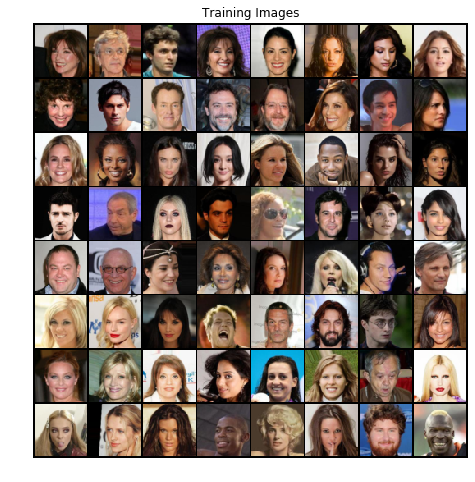

In [ ]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vision_utils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [ ]:
import torch.nn as nn

In [ ]:
# Will be called by the Generator and Discriminator networks
def weights_init(m):
  classname = m.__class__.__name__ # Nice trick!
  if classname.find('Conv') != -1:
    nn.init.normal_(m.weight.data, 0., .02)
  elif classname.find('BatchNorm') != -1:
    nn.init.normal_(m.weight.data, 1., .02)
    nn.init.constant_(m.bias.data, 0)

In [ ]:
class Generator(nn.Module):
  def __init__(self, ngpu):
    super(Generator, self).__init__()
    self.ngpu = ngpu
    self.main = nn.Sequential(
      nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
      nn.BatchNorm2d(ngf * 8),
      nn.ReLU(True),
       
      nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
      nn.BatchNorm2d(ngf * 4),
      nn.ReLU(True),
        
      nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
      nn.BatchNorm2d(ngf * 2),
      nn.ReLU(True),
      
      nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
      nn.BatchNorm2d(ngf),
      nn.ReLU(True),
        
      nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
      nn.Tanh()
      # state size. (nc) x 64 x 64 
    )
    
  def forward(self, input):
    return self.main(input)

In [ ]:
# Create the generator
netG = Generator(ngpu).to(device)

# In multi-gpu : Important!
if (device.type == 'cuda') and (ngpu > 1):
  netG = nn.DataParallel(netG, list(range(ngpu)))

In [ ]:
netG.load_state_dict(torch.load('drive/My Drive/netG-ols-10000.pth'), strict=False)

IncompatibleKeys(missing_keys=[], unexpected_keys=[])

In [ ]:
# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [ ]:
class Critic(nn.Module):
  def __init__(self, ngpu):
    super(Critic, self).__init__()
    self.ngpu = ngpu
    self.main = nn.Sequential(
      nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
      nn.LeakyReLU(0.2, inplace=True),
        
      nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
      nn.BatchNorm2d(ndf * 2),
      nn.LeakyReLU(0.2, inplace=True),
        
      nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
      nn.BatchNorm2d(ndf * 4),
      nn.LeakyReLU(0.2, inplace=True),
        
      nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
      nn.BatchNorm2d(ndf * 8),
      nn.LeakyReLU(0.2, inplace=True),
        
      nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
    )
    
  def forward(self, input):
    return self.main(input).view(-1)

In [ ]:
# Create the critic
netC = Critic(ngpu).to(device)

# In multi-gpu : Important!
if (device.type == 'cuda') and (ngpu > 1):
  netC = nn.DataParallel(netG, list(range(ngpu)))

In [ ]:
netC.load_state_dict(torch.load('drive/My Drive/netC-ols-10000.pth'), strict=False)

IncompatibleKeys(missing_keys=[], unexpected_keys=[])

In [ ]:
netC.apply(weights_init)
print(netC)

Critic(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
  )
)


In [ ]:
import torch.optim as optim

In [ ]:
# Fixed batch of latent vectors for visualizing
# The dimensions are this way because remember that when we are upscaling 
# we have 128 channels with 1x1 feature map
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

real_label = 1
fake_label = 0 

In [ ]:
# Learning rate for optimizers
lr = 4e-4

optimizerC = optim.RMSprop(netC.parameters(), lr=lr)
optimizerG = optim.RMSprop(netG.parameters(), lr=lr)

In [ ]:
def get_infinite_batches(data_loader):
  while True:
      for i, (images, _) in enumerate(data_loader):
          yield images

## Scratch

In [ ]:
x = next(get_infinite_batches(dataloader)).cuda()
d_loss_test = netC(x)

In [ ]:
print(d_loss_test.mean())
print(d_loss_test.mean(0)) 

tensor(0.7176, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7176, device='cuda:0', grad_fn=<MeanBackward2>)


In [ ]:
# To transfer any var to gpu refer the following examples
x = torch.tensor([1])
x.cuda()

x = torch.tensor([1], device=device)
x.type()

tensor([1], device='cuda:0')

In [ ]:
noise = torch.randn(b_size, nz, 1, 1, device=device)
fake_data = netG(noise)
C_G_noise = netC(fake_data)

In [ ]:
G_loss = C_G_noise.mean().mean(0)
print(G_loss)

tensor(1.0163, device='cuda:0', grad_fn=<MeanBackward2>)


## Random Seed Checker


In [ ]:
x = np.random.randn(2,2)
y = torch.randn(2, 2, 1, 1, device=device)
print(x)
print(y)

[[-1.0856306   0.99734545]
 [ 0.2829785  -1.50629471]]
tensor([[[[ 0.0873]],

         [[ 0.5655]]],


        [[[-1.1414]],

         [[ 0.9456]]]], device='cuda:0')


## Training Loop

In [ ]:
from torch.autograd import Variable

In [ ]:
b_size = 256

max_iters = 30000
weight_clip = 0.01
gen_iters = 1
crit_iters = 1

# Lists to keep track of progress
img_list = []
G_losses = []
C_losses = []
diff_G_loss = []
diff_C_loss = []
real_C_res = np.ndarray(max_iters * b_size, dtype=np.float16)
fake_C_res = np.ndarray(max_iters * b_size, dtype=np.float16)

one = torch.FloatTensor([1])
mone = one * -1
one = one.cuda()
m_one = mone.cuda()

In [ ]:
Tensor = torch.cuda.FloatTensor
target_real = Variable(Tensor(b_size).fill_(1.), requires_grad=False)
target_fake = Variable(Tensor(b_size).fill_(0.), requires_grad=False)

In [ ]:
data = get_infinite_batches(dataloader)

## Cost Parameter


In [ ]:
n_steps = 5
cherry_pts = [5000]
i = 5000
increment = (max_iters - cherry_pts[0]) // n_steps
while i < max_iters:
  cherry_pts.append(i + increment)
  i += increment

In [ ]:
# Cost Parameter
def alpha(it, maxIters, maxAlpha):
#       if(it >= 5000):
#         closest_cherry_loc = 0
#         for i in range(len(cherry_pts)):
#           if it >= cherry_pts[i] and it < cherry_pts[i+1]:
#             closest_cherry_loc = i
#             break
#         if it < cherry_pts[closest_cherry_loc] + ((maxIters - 5000) / (1.75 * n_steps)):
#           return (np.sin(((np.pi / 2) * (it - cherry_pts[closest_cherry_loc] - (maxIters - 5000) / (1.75 * n_steps))) / ((maxIters - 5000) / (1.75 * n_steps))) + (closest_cherry_loc + 1)) * (maxAlpha / n_steps)
#         else:
#           return (closest_cherry_loc + 1) * (maxAlpha / n_steps)
#       else:
  return 0.0

In [ ]:
test = []
for i in range(30000):
  test.append(alpha(i, 30000, 0.3))
print(test[4998], test[4999], test[5000], test[5020], test[5021], test[24449])

0.0 0.0 0.0 0.0 0.0 0.0


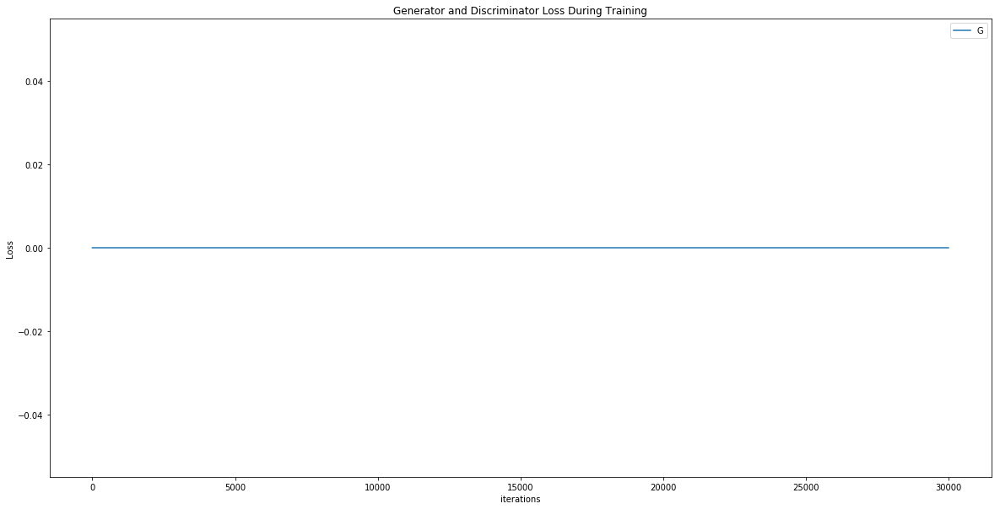

<Figure size 432x288 with 0 Axes>

In [ ]:
plt.figure(figsize=(20,10))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(test,label="G")
# plt.plot(C_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()
plt.savefig('1.png')

## Random Seed Checker 2


In [ ]:
x = np.random.randn(2,2)
y = torch.randn(2, 2, 1, 1, device=device)
print(x)
print(y)

[[-1.0856306   0.99734545]
 [ 0.2829785  -1.50629471]]
tensor([[[[ 0.0873]],

         [[ 0.5655]]],


        [[[-1.1414]],

         [[ 0.9456]]]], device='cuda:0')


In [ ]:
import os
import shutil

[50/30000]	Loss_C: 0.5787	Loss_G: 0.3459	 alpha: 0.0000
[100/30000]	Loss_C: 1.0399	Loss_G: 0.0898	 alpha: 0.0000
[150/30000]	Loss_C: 0.6251	Loss_G: 0.4819	 alpha: 0.0000
[200/30000]	Loss_C: 0.3320	Loss_G: 0.2269	 alpha: 0.0000
[250/30000]	Loss_C: 0.5598	Loss_G: 0.0837	 alpha: 0.0000
[300/30000]	Loss_C: 0.7440	Loss_G: 0.0330	 alpha: 0.0000
[350/30000]	Loss_C: 1.1050	Loss_G: 0.1120	 alpha: 0.0000
[400/30000]	Loss_C: 0.6769	Loss_G: 0.0483	 alpha: 0.0000
[450/30000]	Loss_C: 1.2871	Loss_G: 0.1404	 alpha: 0.0000
[500/30000]	Loss_C: 1.0396	Loss_G: 0.1277	 alpha: 0.0000
[550/30000]	Loss_C: 0.6634	Loss_G: 0.0202	 alpha: 0.0000
[600/30000]	Loss_C: 1.2220	Loss_G: 0.1522	 alpha: 0.0000
[650/30000]	Loss_C: 1.1457	Loss_G: 1.3783	 alpha: 0.0000
[700/30000]	Loss_C: 1.4903	Loss_G: 0.1488	 alpha: 0.0000
[750/30000]	Loss_C: 0.3434	Loss_G: 0.0742	 alpha: 0.0000
[800/30000]	Loss_C: 0.5699	Loss_G: 0.6061	 alpha: 0.0000
[850/30000]	Loss_C: 0.6670	Loss_G: 0.0250	 alpha: 0.0000
[900/30000]	Loss_C: 0.4722	Loss_

IndexError: ignored

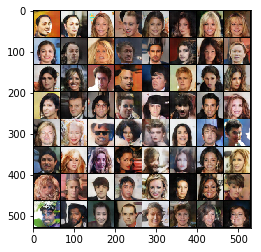

In [ ]:
for i in range(1, max_iters + 1):
  
  # Since, Critic will be updated first.
  for p in netC.parameters():
    p.requires_grad = True
    
  C_loss = 0.
  for j in range(1, crit_iters + 1):
    # Update Critic network.
      
    netC.zero_grad()
        
    # Sample data from real distribution
    real_data = next(data).cuda()
    
    # Sample data from fake distribution
    noise = torch.randn(b_size, nz, 1, 1, device=device)
    fake_data = netG(noise) 
    
    # Getting the outputs of Critic
    C_real = netC(real_data)
    C_fake = netC(fake_data.detach()) # To remove it from the graph
    
    # Finding the errors
    C_loss_real = 0.5 * ((C_real - 1.0)**2).mean().view(1) # mean along rows
    C_loss_real.backward()
    
    C_loss_fake = 0.5 * ((C_fake - 0.0 - alpha(i, max_iters, 0.5))**2).mean().view(1)
    C_loss_fake.backward()
    
    
    C_loss = C_loss_fake + C_loss_real # -V(D,G)
#     Wasserstein_D = -(C_loss_fake / (1 - alpha(i, max_iters, 0.5))  + C_loss_real)
    optimizerC.step()
    
    # Clip the weights of Critic network
#     for p in netC.parameters():
#       p.data.clamp_(-weight_clip, weight_clip)
      
    # Getting real_critic_results
    if (j % crit_iters == (crit_iters - 1)):
      if len(real_data) == b_size:
        for k in range(b_size):
          real_C_res[b_size * i + k] = C_real[k]
      else:
        real_data1 = next(data).cuda()
        C_real1 = netC(real_data1)
        for k in range(b_size):
          real_C_res[b_size * i + k] = C_real1[k]
  
  G_loss = 0.    
  # Update Generator network.
  for p in netC.parameters():
     p.requires_grad = False  # to avoid computation

  for j in range(1, gen_iters + 1):
    # Update Generator network.
    netG.zero_grad()

    # Sample data from fake distribution
    noise = torch.randn(b_size, nz, 1, 1, device=device)
    fake_data = netG(noise)

    # Finding the error
    C_G_noise = netC(fake_data)
    G_loss = 0.5 * ((C_G_noise - 1.0)**2).mean().view(1)
    G_loss.backward()
    G_cost = G_loss
    optimizerG.step()
    
    # Getting fake_critic_results
    for k in range(b_size):
        fake_C_res[b_size * i + k] = C_G_noise[k]
    
    
    
  # Display Results
  if i % 50 == 0:
    print('[%d/%d]\tLoss_C: %.4f\tLoss_G: %.4f\t alpha: %.4f'
        % (i, max_iters, C_loss.item(), G_loss.item(), alpha(i, max_iters, 0.5)))


  # Save Losses for plotting later
  G_losses.append(G_loss.item())
  C_losses.append(C_loss.item())  
  
  if (i > 1):
    diff_G_loss.append(G_losses[i-1] - G_losses[i-2])
    diff_C_loss.append(C_losses[i-1] - C_losses[i-2])

  # Display images
  # Check how the generator is doing by saving G's output on fixed_noise
  if (i % 1000 == 0):
    with torch.no_grad():
       fake = netG(fixed_noise).detach().cpu()
    img_list.append(vision_utils.make_grid(fake, padding=2, normalize=True))
    plt.imshow(np.transpose(vision_utils.make_grid(img_list[-1].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
    
  if i % 5000 == 0:
    torch.save(netC.state_dict(), "./netC-ols-1-{}.pth".format(i))
    torch.save(netG.state_dict(), "./netG-ols-1-{}.pth".format(i))
    shutil.copy("./netC-ols-1-{}.pth".format(i), './drive/My Drive/')
    shutil.copy("./netG-ols-1-{}.pth".format(i), './drive/My Drive/')

In [ ]:
np.save('ols-real_C_res.npy', real_C_res)
np.save('ols-fake_C_res.npy', fake_C_res)
np.save('ols-G_losses.npy', np.array(G_losses))
np.save('ols-C_losses.npy', np.array(C_losses))

In [ ]:
shutil.copy('ols-real_C_res.npy', './drive/My Drive/')
shutil.copy('ols-fake_C_res.npy', './drive/My Drive/')
shutil.copy('ols-G_losses.npy', './drive/My Drive/')
shutil.copy('ols-C_losses.npy', './drive/My Drive/')

'./drive/My Drive/ols-C_losses.npy'

In [ ]:
for i in range(len(img_list)):
  img_list[i] = img_list[i].numpy()

In [ ]:
np.save('ols-img_list.npy', img_list)
shutil.copy('ols-img_list.npy', './drive/My Drive/')

'./drive/My Drive/ols-img_list.npy'

# Graphs

## Error graphs

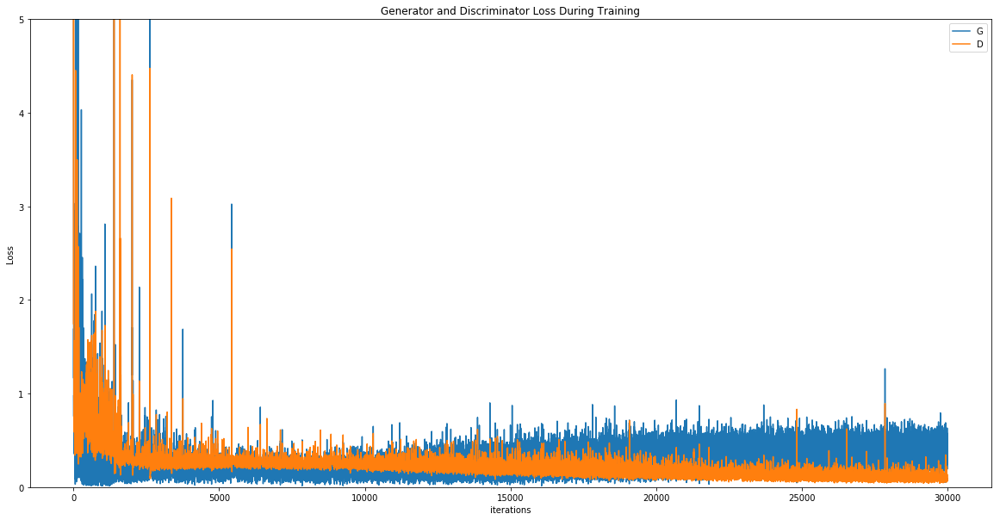

<Figure size 432x288 with 0 Axes>

In [ ]:
plt.figure(figsize=(20,10))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(C_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.ylim(0,5)
plt.legend()
plt.show()
plt.savefig('1.png')

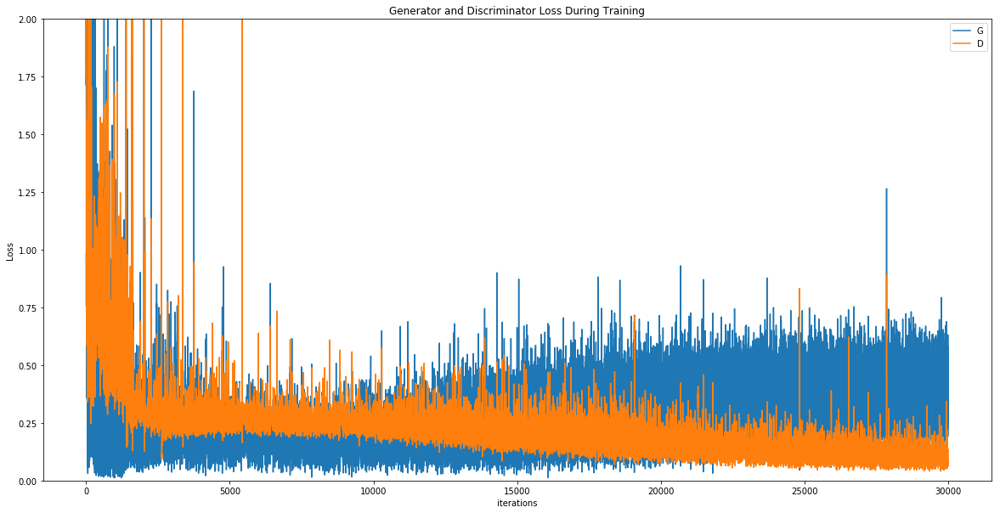

<Figure size 432x288 with 0 Axes>

In [ ]:
plt.figure(figsize=(20,10))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(C_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.ylim(0,2)
plt.legend()
plt.show()
plt.savefig('1.png')

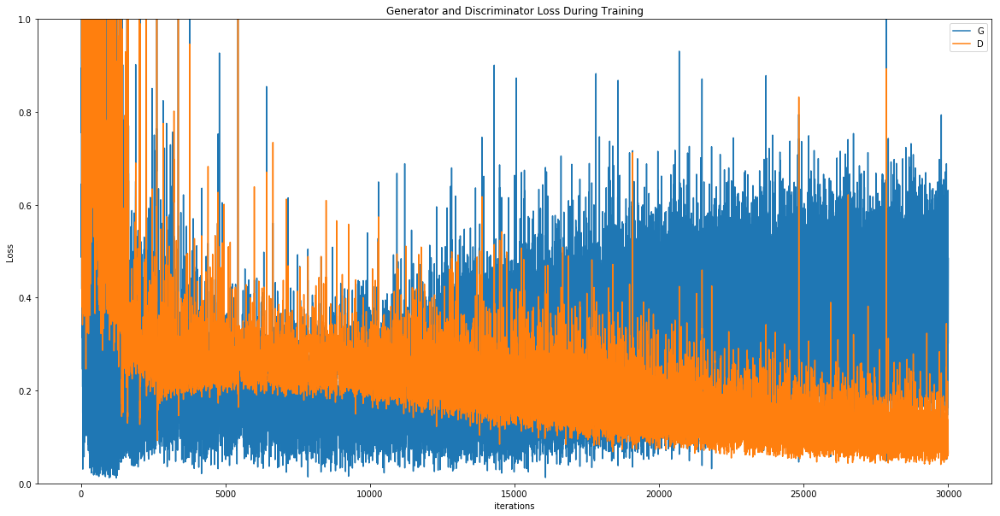

<Figure size 432x288 with 0 Axes>

In [ ]:
plt.figure(figsize=(20,10))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(C_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.ylim(0,1)
plt.legend()
plt.show()
plt.savefig('1.png')

In [ ]:
print("Max G_loss", str(max(G_losses)))
print("Min G_loss", str(min(G_losses)))
print("Max C_loss", str(max(C_losses)))
print("Min C_loss", str(min(C_losses)))

Max G_loss 0.6330869197845459
Min G_loss -0.5141443014144897
Max C_loss -0.027888774871826172
Min C_loss -1.0467357635498047


In [ ]:
xs = np.arange(len(G_losses))

In [ ]:
len(G_losses), len(C_losses), len(diff_G_loss), len(diff_C_loss)

(4000, 4000, 3998, 3998)

In [ ]:
?plt.scatter

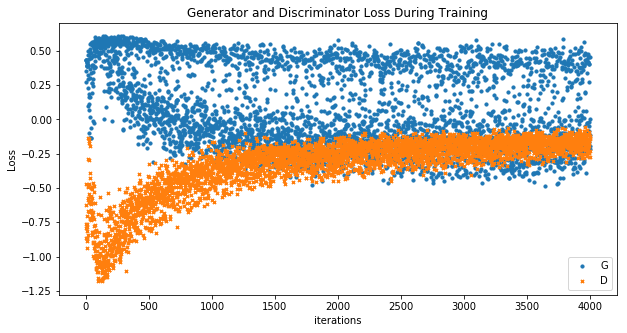

<Figure size 432x288 with 0 Axes>

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.scatter(xs, G_losses,label="G", s=10)
plt.scatter(xs, C_losses,label="D", marker='x', s=10)
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()
plt.savefig('2.png')

In [ ]:
128 * 11650

In [ ]:
l // 2

1600000

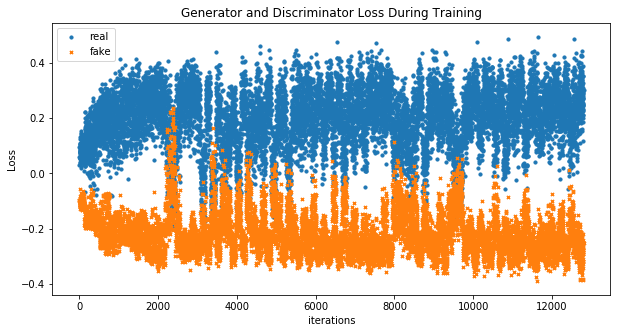

<Figure size 432x288 with 0 Axes>

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.scatter(np.arange(12800), real_C_res[:12800] ,label="real", s=10)
plt.scatter(np.arange(12800), fake_C_res[:12800], label="fake", marker='x', s=10)
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()
plt.savefig('3.png')

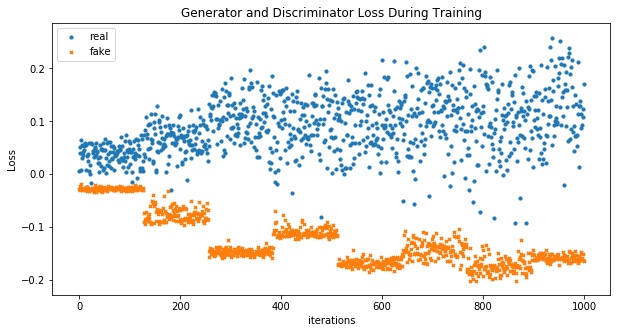

<Figure size 432x288 with 0 Axes>

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.scatter(np.arange(1000), real_C_res[:1000] ,label="real", s=10)
plt.scatter(np.arange(1000), fake_C_res[:1000], label="fake", marker='x', s=10)
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()
plt.savefig('3.png')

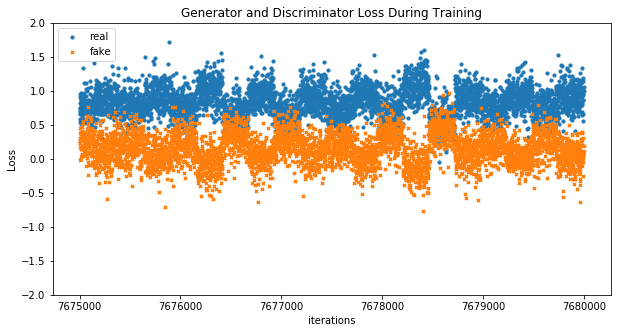

<Figure size 432x288 with 0 Axes>

In [ ]:
l = len(real_C_res)
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.scatter(np.arange(l-5000, l), real_C_res[l-5000: l] ,label="real", s=10)
plt.scatter(np.arange(l-5000, l), fake_C_res[l-5000: l], label="fake", marker='x', s=10)
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.ylim(-2,2)
plt.legend()
plt.show()
plt.savefig('3.png')

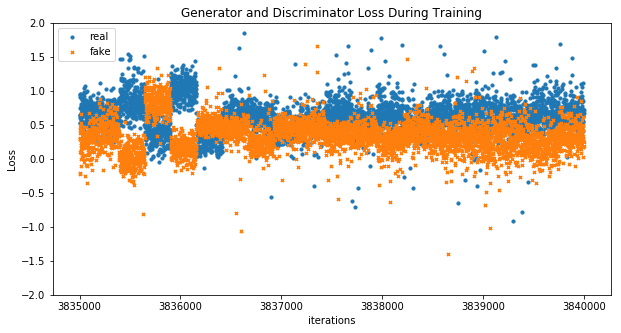

<Figure size 432x288 with 0 Axes>

In [ ]:
l = len(real_C_res) // 2
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.scatter(np.arange(l-5000, l), real_C_res[l-5000: l] ,label="real", s=10)
plt.scatter(np.arange(l-5000, l), fake_C_res[l-5000: l], label="fake", marker='x', s=10)
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.ylim(-2,2)
plt.legend()
plt.show()
plt.savefig('3.png')

In [ ]:
l = len(real_C_res)
print(fake_C_res[l-5000: l].mean())
l = l // 2
print(fake_C_res[l-5000: l].mean())
l = l // 2
print(fake_C_res[l-5000: l].mean())
l = l // 2
print(fake_C_res[l-5000: l].mean())

0.1449
0.345
0.3992
0.388


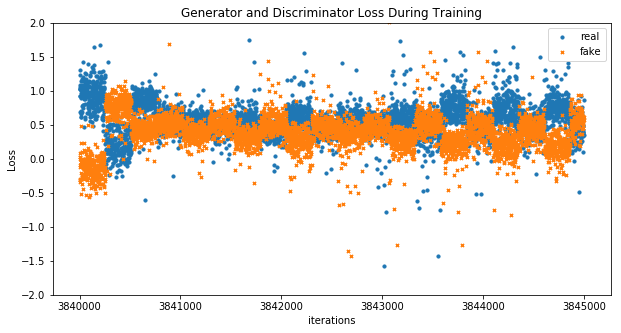

<Figure size 432x288 with 0 Axes>

In [ ]:
l = len(real_C_res) // 2
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.scatter(np.arange(l, l+5000), real_C_res[l: l+5000] ,label="real", s=10)
plt.scatter(np.arange(l, l+5000), fake_C_res[l: l+5000], label="fake", marker='x', s=10)
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.ylim(-2,2)
plt.legend()
plt.show()
plt.savefig('3.png')

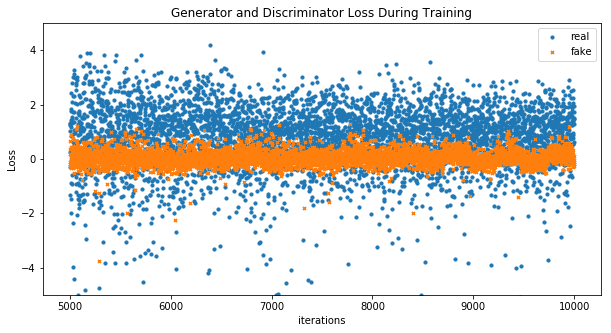

<Figure size 432x288 with 0 Axes>

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.scatter(np.arange(5000, 10000), real_C_res[5000: 10000] ,label="real", s=10)
plt.scatter(np.arange(5000, 10000), fake_C_res[5000: 10000], label="fake", marker='x', s=10)
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.ylim(-5,5)
plt.legend()
plt.show()
plt.savefig('3.png')

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.scatter(np.arange(1600000, 1600100), real_C_res[1600000: 1600100] ,label="real", s=10)
plt.scatter(np.arange(1600000, 1600100), fake_C_res[1600000: 1600100], label="fake", marker='x', s=10)
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()
plt.savefig('5.png')

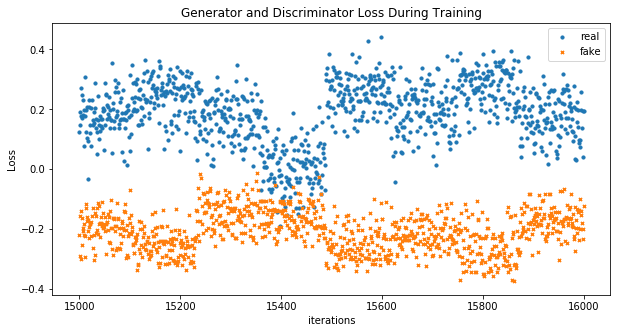

<Figure size 432x288 with 0 Axes>

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.scatter(np.arange(15000, 16000), real_C_res[15000:16000] ,label="real", s=10)
plt.scatter(np.arange(15000, 16000), fake_C_res[15000:16000], label="fake", marker='x', s=10)
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()
plt.savefig('3.png')

## Difference Graphs

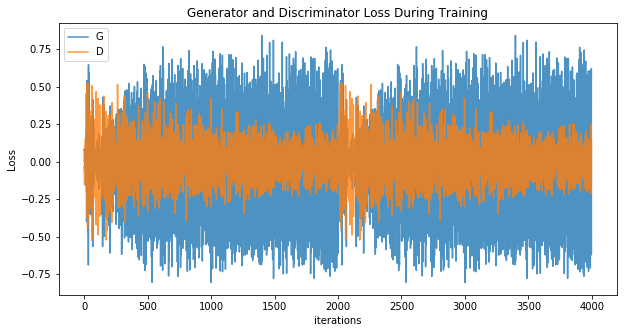

<Figure size 432x288 with 0 Axes>

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(diff_G_loss,label="G", alpha=0.8)
plt.plot(diff_C_loss,label="D", alpha=0.8)
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()
plt.savefig('3.png')

### Finding points of high oscillations
Oscillations are found where changes in error between two consequetive iterations are more than a threshold
(Here, if more than 1/2 of max positive value or less than 1/2 of min negative value 

In [ ]:
graph_G = np.array(diff_G_loss)
graph_C = np.array(diff_C_loss)
xs = len(graph_G)
xs, len(graph_G)

(3998, 3998)

In [ ]:
scatter_G = graph_G.copy()
scatter_C = graph_C.copy()

thres_G = -scatter_G[3000:].min() / 2 # We care more about the oscillations back to the lower error
thres_C = scatter_C[3000:].max() / 2

for i in range(len(scatter_G)):
  if (scatter_G[i] < thres_G and scatter_G[i] > -thres_G):
    scatter_G[i] = 0

for i in range(len(scatter_C)):
  if (scatter_C[i] < thres_C and scatter_C[i] > -thres_C):
    scatter_C[i] = 0

#### Last 200 iterations

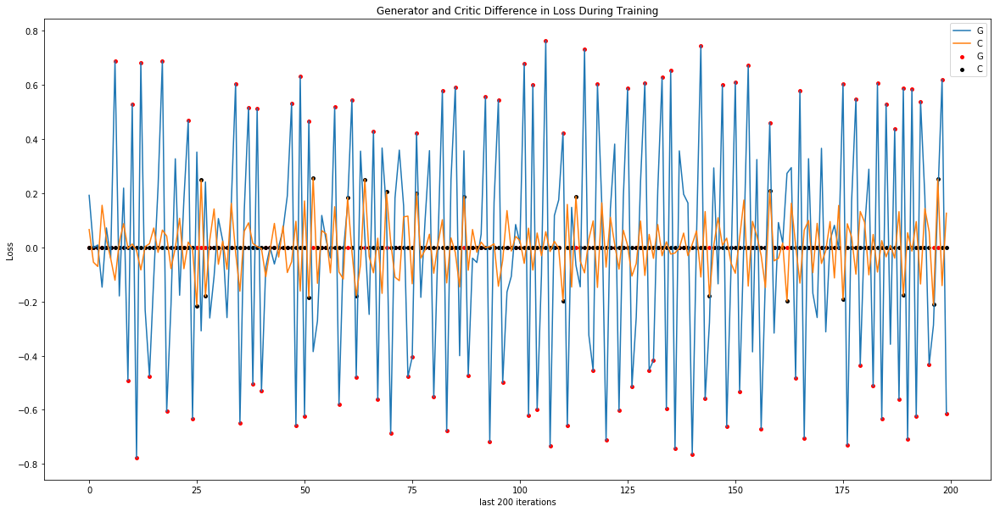

<Figure size 432x288 with 0 Axes>

In [ ]:
plt.figure(figsize=(20,10))
plt.title("Generator and Critic Difference in Loss During Training")
plt.scatter(np.arange(200), scatter_G[-200:],label="G", color='r', s=15)
plt.scatter(np.arange(200), scatter_C[-200:],label="C", color='k', s=15)
plt.plot(np.arange(200), graph_G[-200:],label="G")
plt.plot(np.arange(200), graph_C[-200:],label="C")
plt.xlabel("last 200 iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()
plt.savefig('4.png')

#### Last 100 iterations

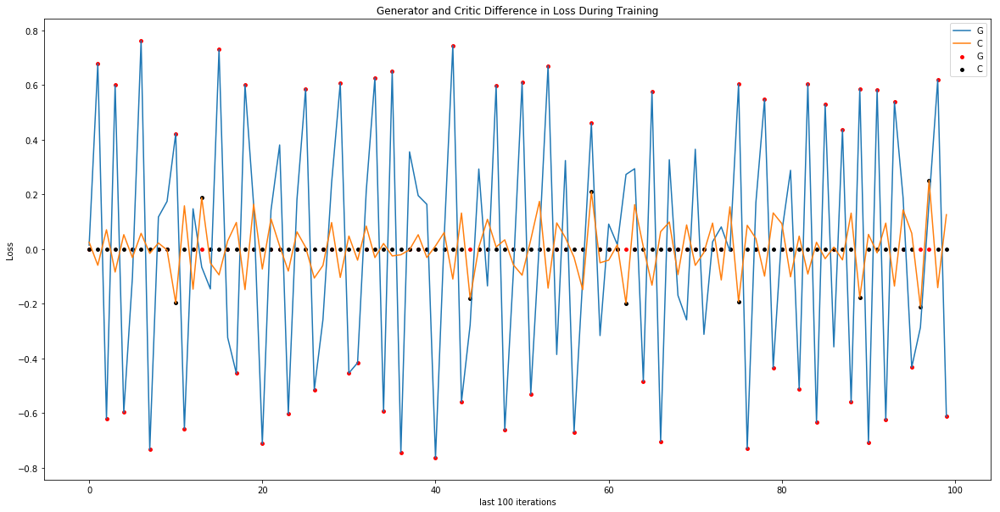

<Figure size 432x288 with 0 Axes>

In [ ]:
plt.figure(figsize=(20,10))
plt.title("Generator and Critic Difference in Loss During Training")
plt.scatter(np.arange(100), scatter_G[-100:],label="G", color='r', s=15)
plt.scatter(np.arange(100), scatter_C[-100:],label="C", color='k', s=15)
plt.plot(np.arange(100), graph_G[-100:],label="G")
plt.plot(np.arange(100), graph_C[-100:],label="C")
plt.xlabel("last 100 iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()
plt.savefig('5.png')

## More severe threshold

In [ ]:
scatter_G = graph_G.copy()
scatter_C = graph_C.copy()

thres_G = -scatter_G[3000:].min() * 0.75
thres_C = scatter_C[3000:].max() * 0.75

for i in range(len(scatter_G)):
  if (scatter_G[i] < thres_G and scatter_G[i] > -thres_G):
    scatter_G[i] = 0

for i in range(len(scatter_C)):
  if (scatter_C[i] < thres_C and scatter_C[i] > -thres_C):
    scatter_C[i] = 0

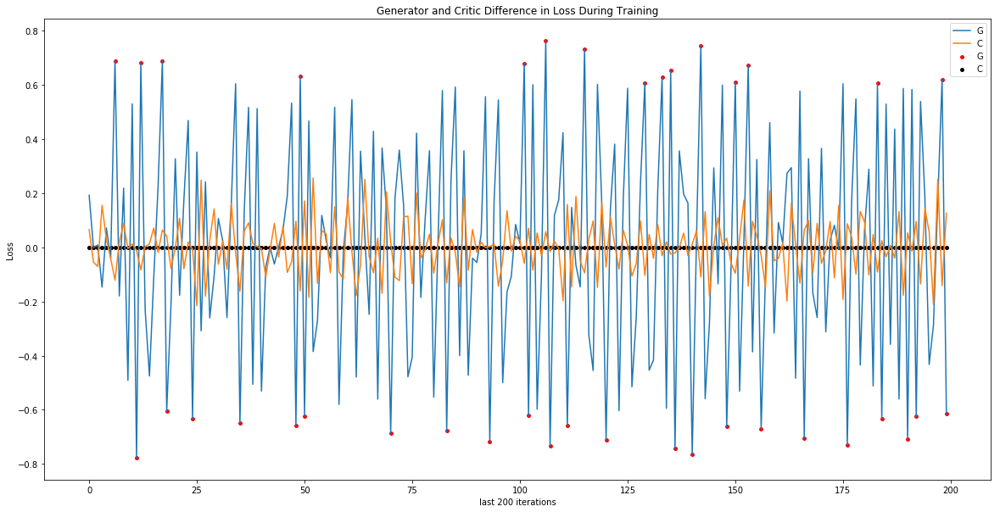

<Figure size 432x288 with 0 Axes>

In [ ]:
plt.figure(figsize=(20,10))
plt.title("Generator and Critic Difference in Loss During Training")
plt.scatter(np.arange(200), scatter_G[-200:],label="G", color='r', s=15)
plt.scatter(np.arange(200), scatter_C[-200:],label="C", color='k', s=15)
plt.plot(np.arange(200), graph_G[-200:],label="G")
plt.plot(np.arange(200), graph_C[-200:],label="C")
plt.xlabel("last 200 iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()
plt.savefig('5.png')

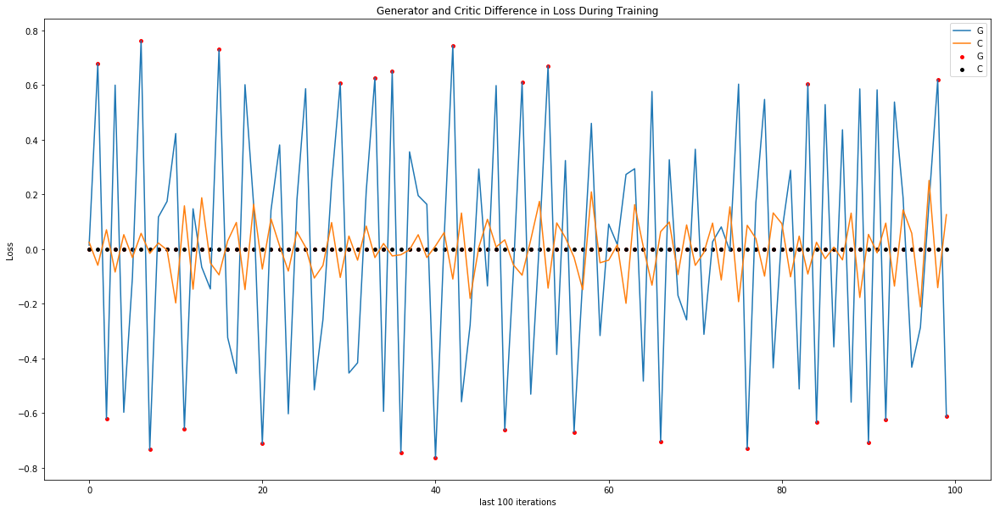

<Figure size 432x288 with 0 Axes>

In [ ]:
plt.figure(figsize=(20,10))
plt.title("Generator and Critic Difference in Loss During Training")
plt.scatter(np.arange(100), scatter_G[-100:],label="G", color='r', s=15)
plt.scatter(np.arange(100), scatter_C[-100:],label="C", color='k', s=15)
plt.plot(np.arange(100), graph_G[-100:],label="G")
plt.plot(np.arange(100), graph_C[-100:],label="C")
plt.xlabel("last 100 iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()
plt.savefig('6.png')

In [ ]:
import matplotlib.animation as animation
from IPython.display import HTML

Animation size has reached 21327010 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


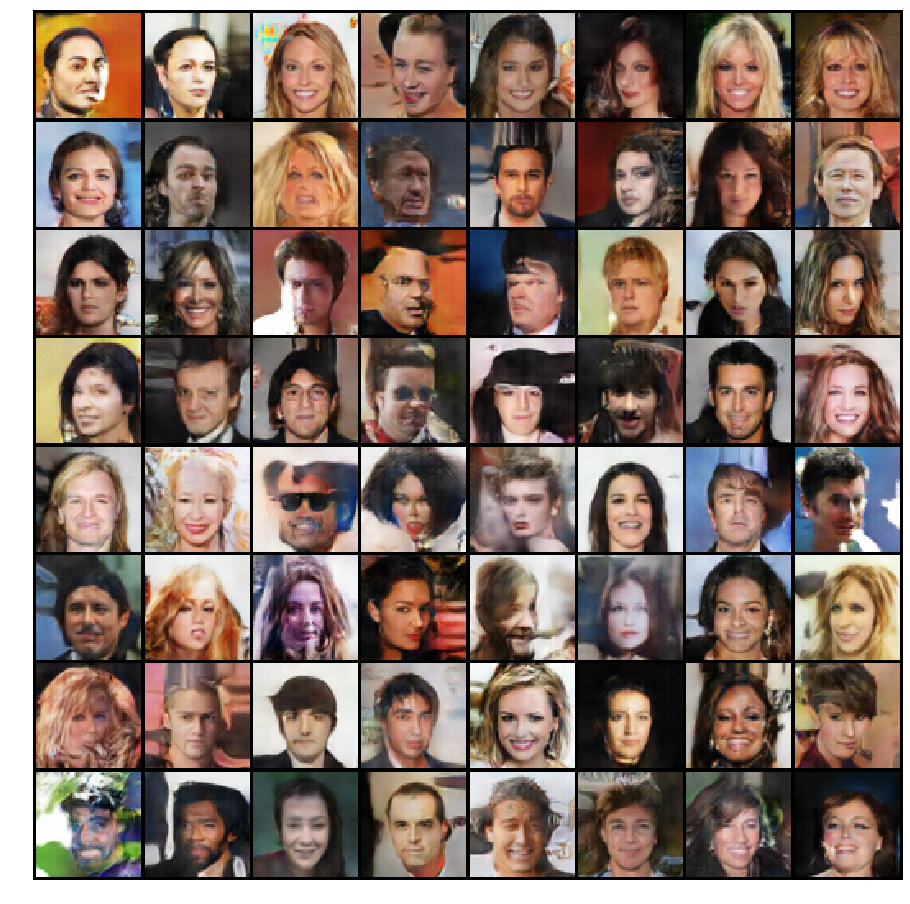

In [ ]:
#%%capture
fig = plt.figure(figsize=(16,16))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [ ]:
d = next(data)

In [ ]:
!nvidia-smi

Tue Jun 11 04:34:42 2019       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 418.67       Driver Version: 410.79       CUDA Version: 10.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   69C    P0    31W /  70W |   1885MiB / 15079MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

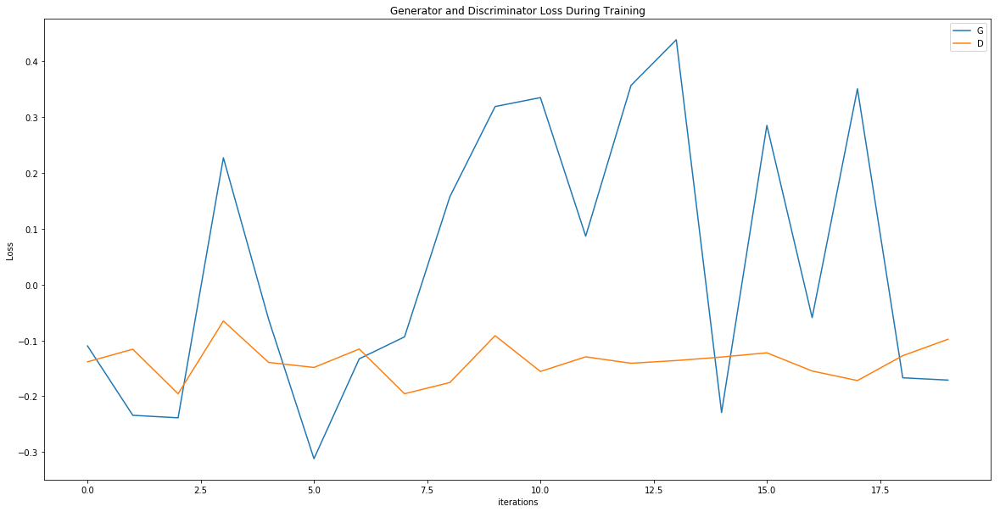

<Figure size 432x288 with 0 Axes>

In [ ]:
plt.figure(figsize=(20,10))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses[-20:],label="G")
plt.plot(C_losses[-20:],label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()
plt.savefig('1b.png')

In [ ]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list[-10:]]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [ ]:
noise = torch.randn(b_size, nz, 1, 1, device=device)
fake_dat = netG(noise).detach()

NameError: ignored

In [ ]:
plt.figure(figsize=(16,16))
plt.axis("off")
plt.title("Example Images")
plt.imshow(np.transpose(vision_utils.make_grid(fake_dat[:32], padding=2, normalize=True).cpu(),(1,2,0)))

NameError: ignored

In [ ]:
data = get_infinite_batches(dataloader)
test = netC(next(data).cuda()).detach()

In [ ]:
noise = torch.randn(b_size, nz, 1, 1, device=device)
fake_dat = netG(noise) 
test_fake = netC(fake_dat.detach())
print(test_fake)

tensor([-0.0086, -0.0159,  0.0049, -0.0387,  0.0013, -0.0421, -0.0343, -0.0024,
        -0.0177, -0.0344, -0.0603, -0.0092,  0.0009,  0.0234, -0.0180, -0.0230,
         0.0326,  0.0046,  0.0023, -0.0287, -0.0472,  0.0260, -0.0055,  0.0102,
         0.0128, -0.0601, -0.0334, -0.0056, -0.0334, -0.0360, -0.0148, -0.0150,
        -0.0340, -0.0162, -0.0211, -0.0280,  0.0127, -0.0142, -0.0691, -0.0545,
        -0.0520, -0.0519, -0.0419, -0.0512, -0.0002,  0.0250, -0.0594, -0.0189,
        -0.0246,  0.0260,  0.0028, -0.0098,  0.0183, -0.0449, -0.0110, -0.0336,
        -0.0526,  0.0260, -0.0062,  0.0080,  0.0150,  0.0028, -0.0499, -0.0299,
        -0.0270, -0.0236,  0.0250, -0.0542, -0.0114, -0.0348,  0.0257, -0.0326,
        -0.0030, -0.0027,  0.0099, -0.0007, -0.0167, -0.0343, -0.0508, -0.0070,
        -0.0461, -0.0405, -0.0186, -0.0389, -0.0166, -0.0007, -0.0041,  0.0062,
        -0.0423, -0.0453, -0.0343,  0.0491, -0.0515, -0.0485, -0.0079,  0.0088,
         0.0235, -0.0350, -0.0009,  0.01

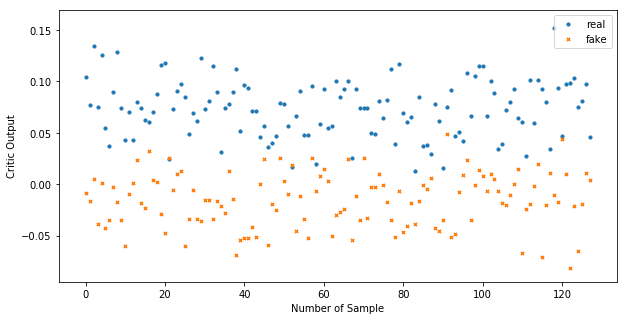

<Figure size 432x288 with 0 Axes>

In [ ]:
plt.figure(figsize=(10,5))
# plt.title("Generator and Discriminator Loss During Training")
plt.scatter(np.arange(128), test.cpu(), label="real", s=10)
plt.scatter(np.arange(128), test_fake.detach().cpu(), label="fake", marker='x', s=10)
plt.xlabel("Number of Sample")
plt.ylabel("Critic Output")
plt.legend()
plt.show()
plt.savefig('10.png')

In [ ]:
test.mean(), test_fake.mean()